<div style="background-color:pink; padding:20px; text-align:center; font-weight: bold;">
    <h2>Image Processing Techniques 🪄</h2>
    <ul>
        <li>Smoothing</li>
        <li>Sharpening</li>
        <li>Blurring</li>
    </ul>
</div>






### First we import some important libraries :

In [32]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image , ImageEnhance
import cv2
import os


### Create a Data Frame with the images we will use :

In [2]:

image_filenames = ['ge4.jpg', 'ge3.jpg', 'ge2.jpg', 'ge1.jpg', 'lena.jpg','fl1.jpg','fl2.jpg','fl3.jpg','fl4.jpg','fl5.jpg']

df = pd.DataFrame({'image': image_filenames})

df.to_csv('image_filenames.csv')

df


,image
0,ge4.jpg
1,ge3.jpg
2,ge2.jpg
3,ge1.jpg
4,lena.jpg
5,fl1.jpg
6,fl2.jpg
7,fl3.jpg
8,fl4.jpg
9,fl5.jpg


<div style="background-color:pink; padding:20px; text-align:center; font-weight: bold;">
    <h2>Smoothing</h2>
</div>


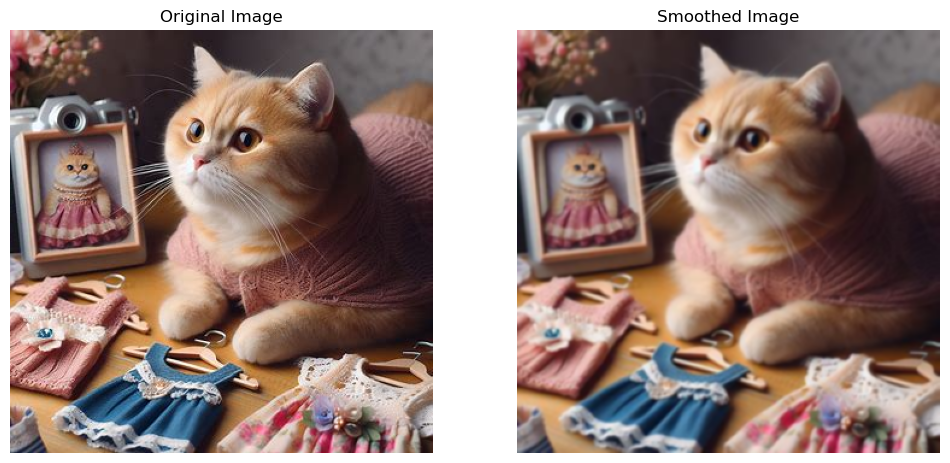

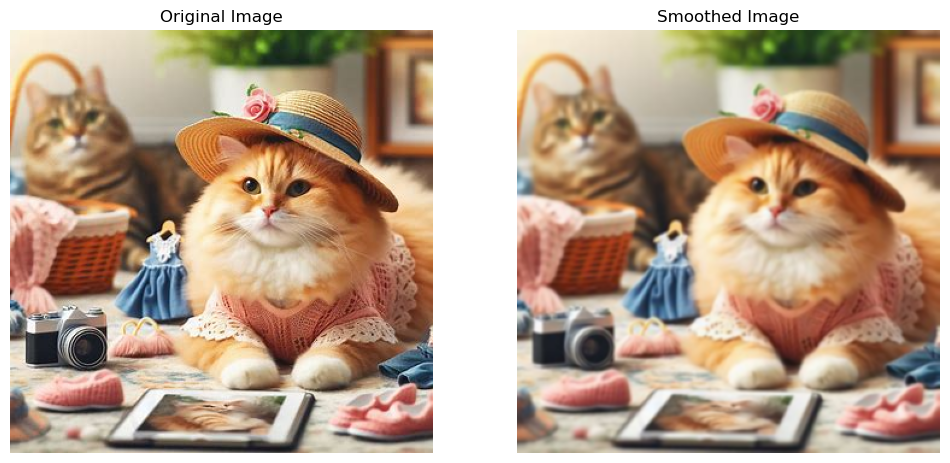

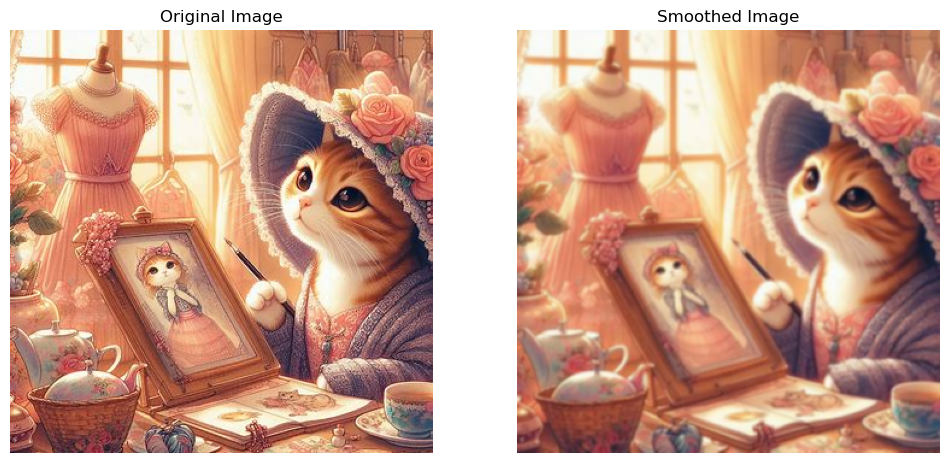

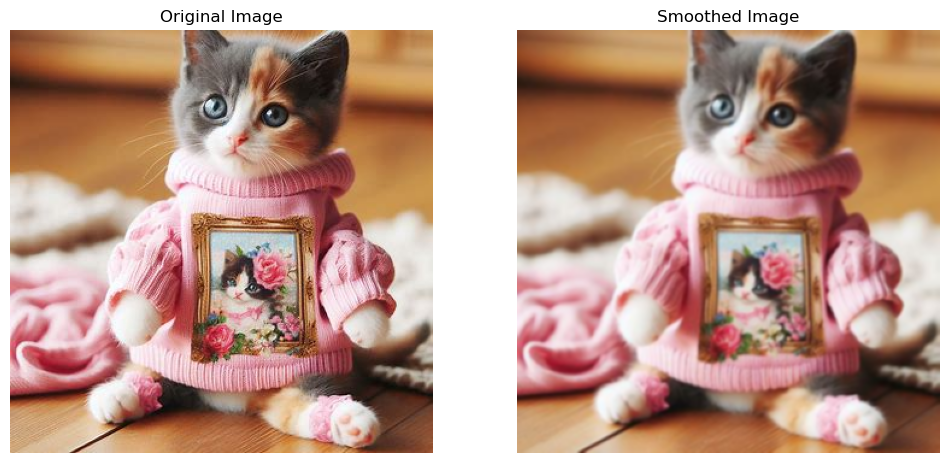

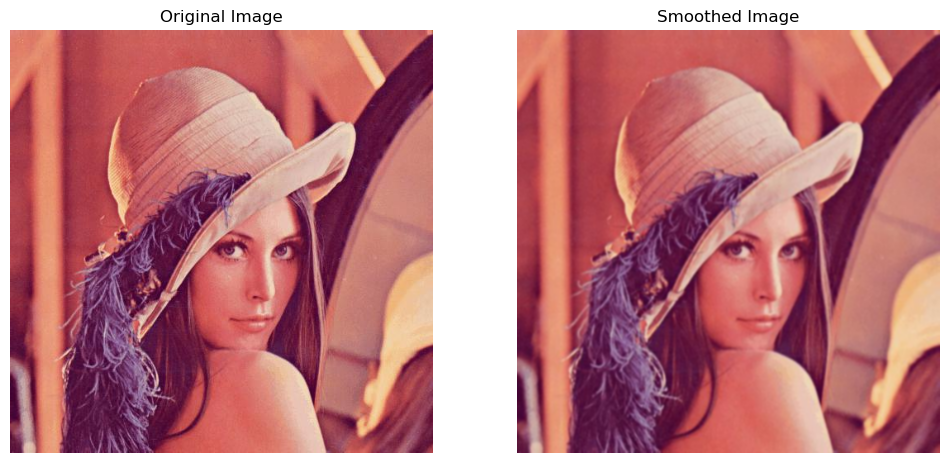

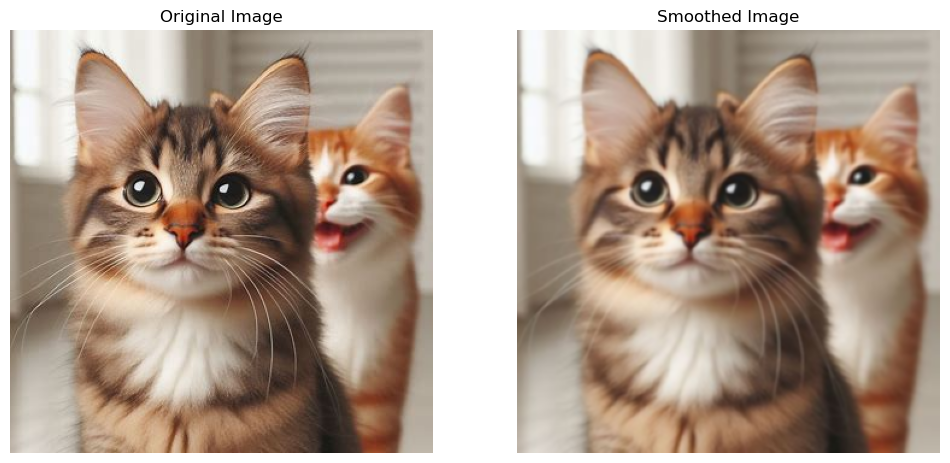

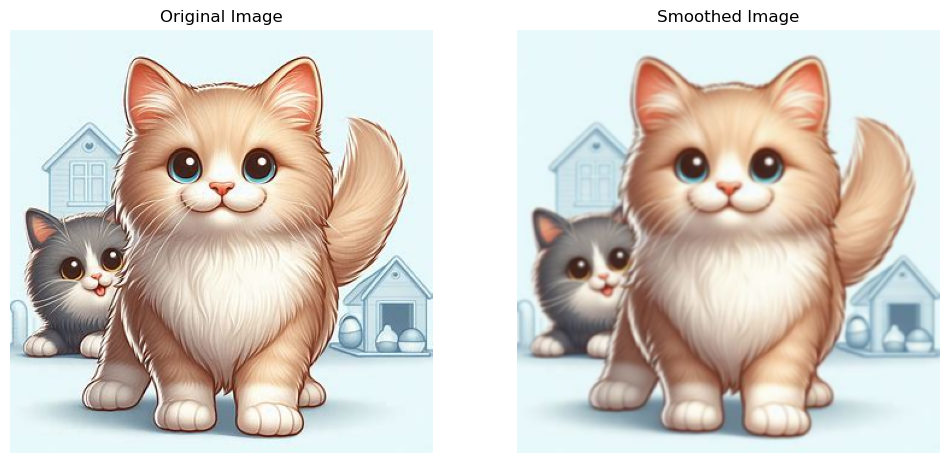

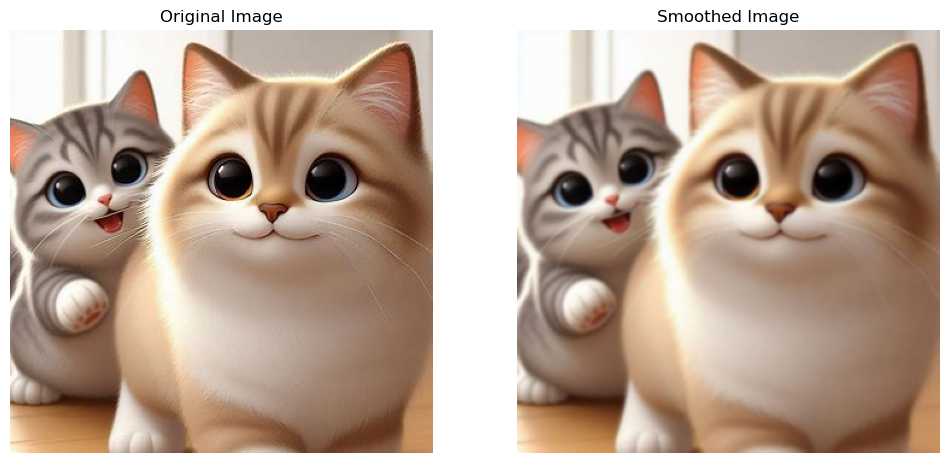

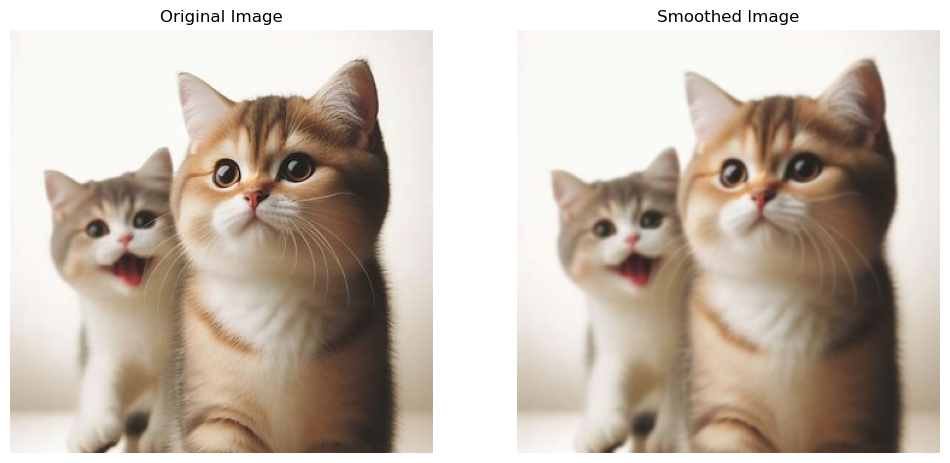

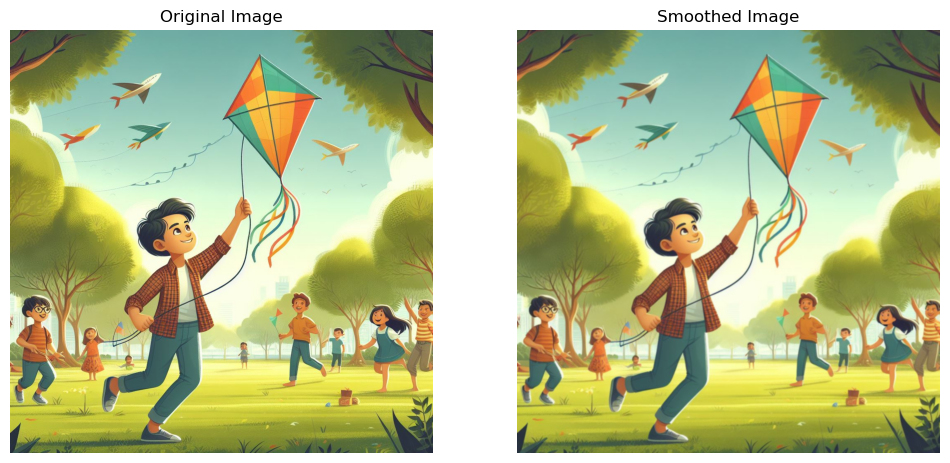

In [4]:

# Iterate over each row in the DataFrame
for index, row in df.iterrows():
    # Read the input image
    input_image = cv2.imread(row['image'])

    # Check if the image is loaded successfully
    if input_image is None:
        print(f"Error: Unable to load image at index {index}")
    else:
        # Apply Gaussian blur to smooth the image
        smoothed_image = cv2.GaussianBlur(input_image, (5, 5), 0)

        # Display the original and smoothed images
        fig, axes = plt.subplots(1, 2, figsize=(12, 6))
        axes[0].imshow(cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB))
        axes[0].set_title("Original Image")
        axes[0].axis('off')
        axes[1].imshow(cv2.cvtColor(smoothed_image, cv2.COLOR_BGR2RGB))
        axes[1].set_title("Smoothed Image")
        axes[1].axis('off')
        plt.show()


<div style="background-color:pink; padding:20px; text-align:center; font-weight: bold;">
    <h2>Sharpening</h2>
</div>


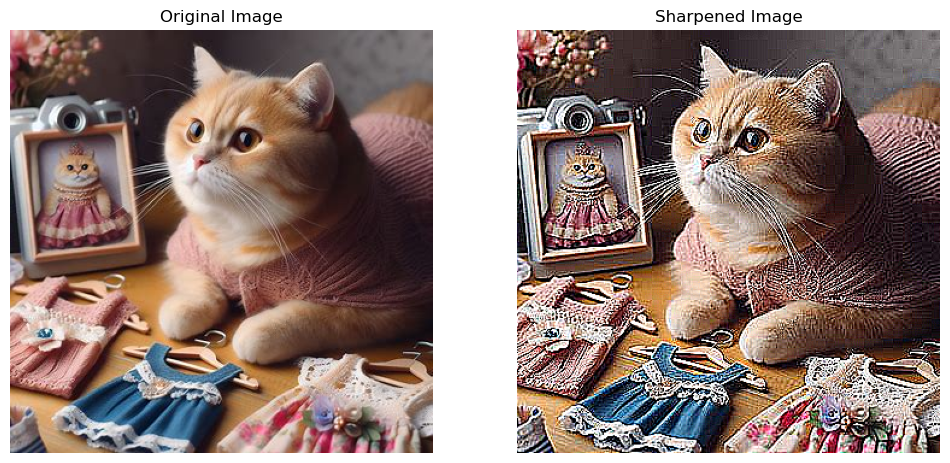

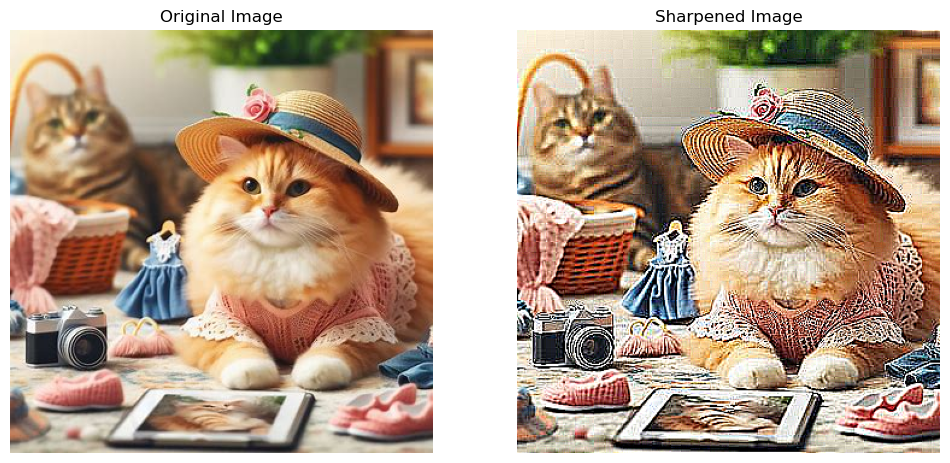

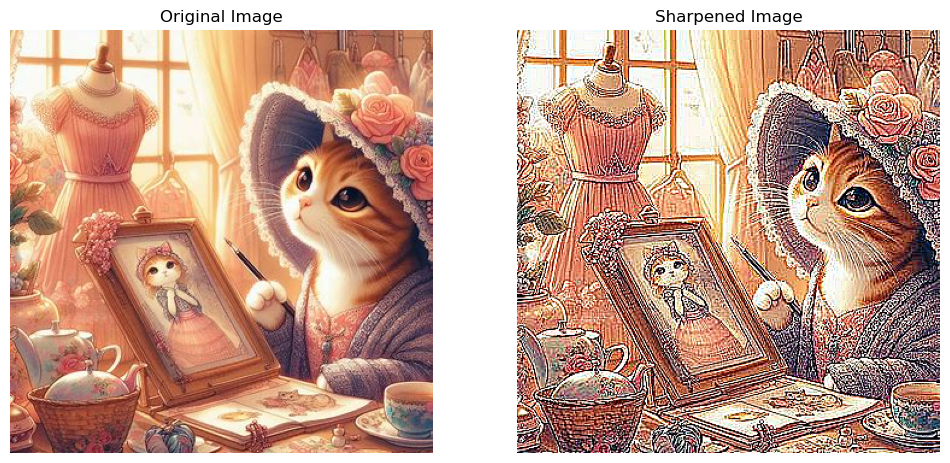

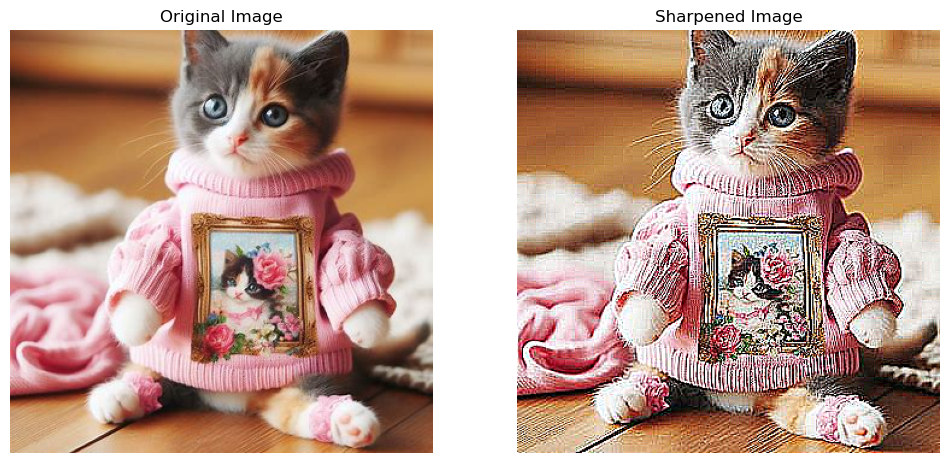

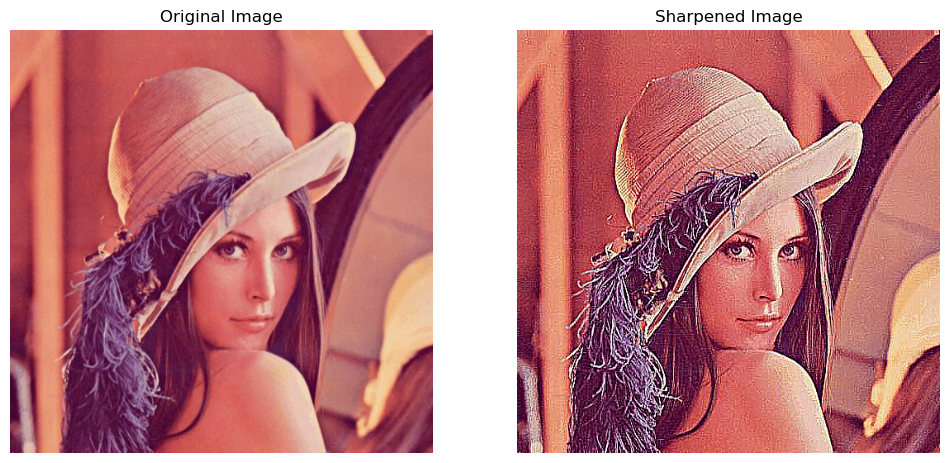

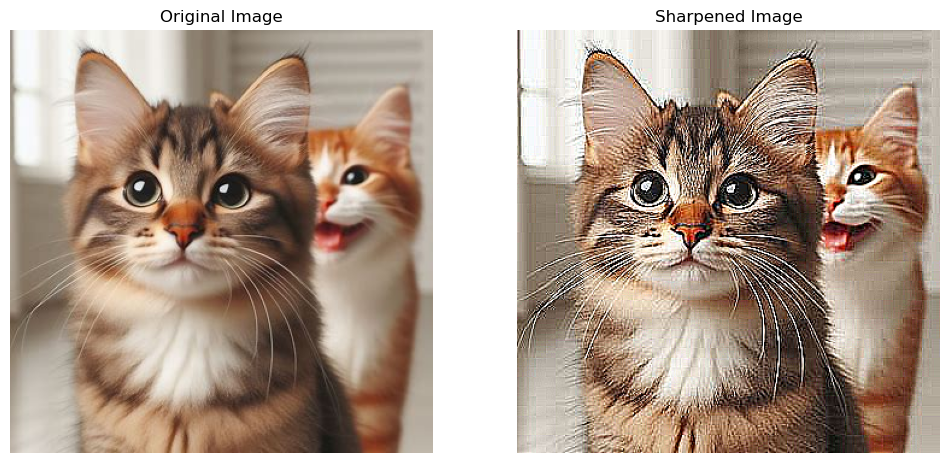

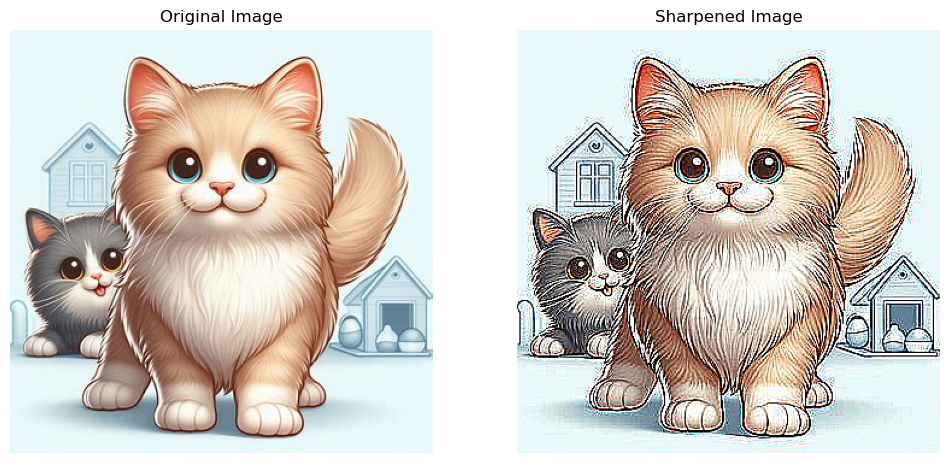

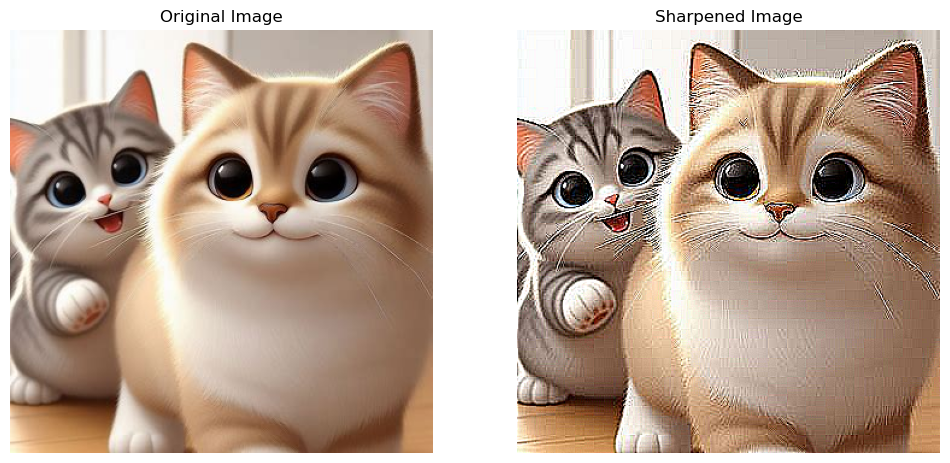

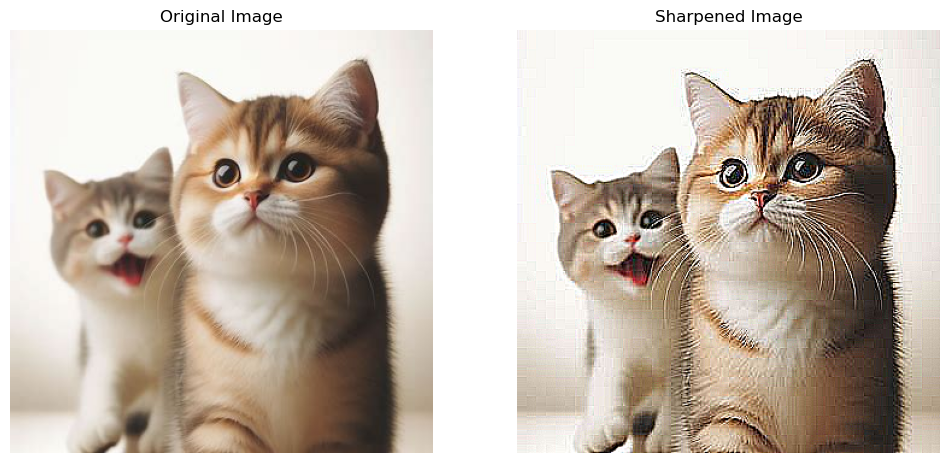

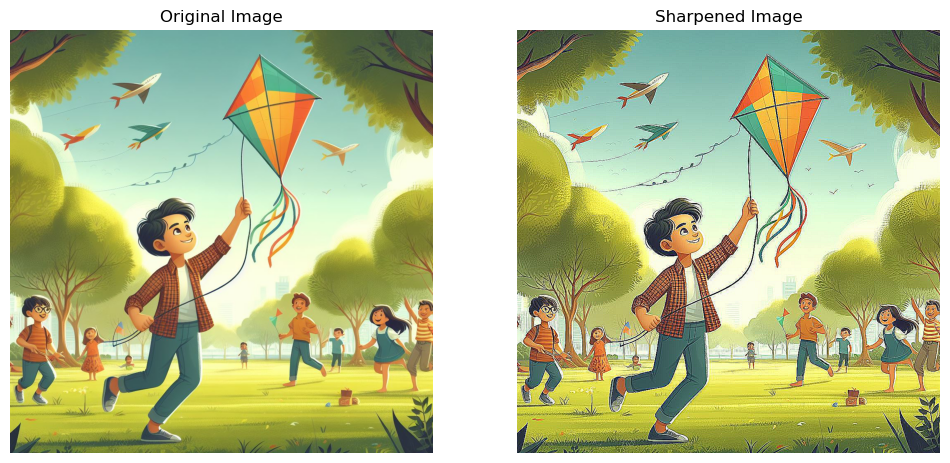

In [5]:

# Define the sharpening filter
sharpen_filter = np.array([[-1, -1, -1],
                            [-1, 9, -1],
                            [-1, -1, -1]])


# Iterate over each row in the DataFrame
for index, row in df.iterrows():
    # Read the input image
    input_image = cv2.imread(row['image'])

    # Check if the image is loaded successfully
    if input_image is None:
        print(f"Error: Unable to load image at index {index}")
    else:
        # Apply sharpening filter
        sharpened_image = cv2.filter2D(input_image, -1, sharpen_filter)

       
        fig, axes = plt.subplots(1, 2, figsize=(12, 6))
        axes[0].imshow(cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB))
        axes[0].set_title("Original Image")
        axes[0].axis('off')
        axes[1].imshow(cv2.cvtColor(sharpened_image, cv2.COLOR_BGR2RGB))
        axes[1].set_title("Sharpened Image")
        axes[1].axis('off')
        plt.show()


<div style="background-color:pink; padding:20px; text-align:center; font-weight: bold;">
    <h2>Blurring</h2>
</div>


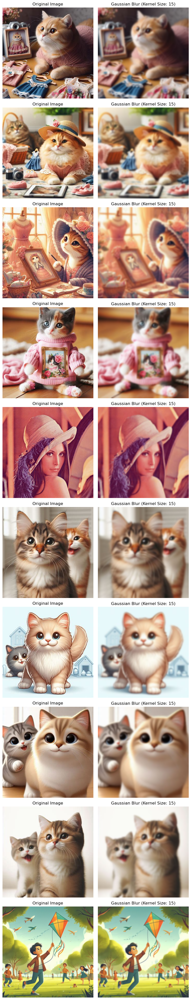

In [6]:



# Function to apply Gaussian blur with adjustable kernel size
def apply_gaussian_blur(image_path, kernel_size):
    # Read the image
    img = cv2.imread(image_path)
    
    # Apply Gaussian blur with the specified kernel size
    blurred_img = cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)
    
    return blurred_img

# Control the degree of blur by adjusting the kernel size
kernel_size = 15  # Adjust this parameter to control the degree of blur

# Apply Gaussian blur with adjustable kernel size to each image in the DataFrame
processed_images = []
for idx, row in df.iterrows():
    blurred_img = apply_gaussian_blur(row['image'], kernel_size)
    processed_images.append(blurred_img)

# Display the original and processed images
fig, axes = plt.subplots(len(processed_images), 2, figsize=(8, len(processed_images)*4))
for i, (original_img, blurred_img) in enumerate(zip(df['image'], processed_images)):
    original = cv2.imread(original_img)
    axes[i, 0].imshow(cv2.cvtColor(original, cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title("Original Image")
    axes[i, 0].axis('off')
    
    axes[i, 1].imshow(cv2.cvtColor(blurred_img, cv2.COLOR_BGR2RGB))
    axes[i, 1].set_title(f"Gaussian Blur (Kernel Size: {kernel_size})")
    axes[i, 1].axis('off')

plt.tight_layout()
plt.show()
